<a href="https://colab.research.google.com/github/yrodriguezmd/IceVision_miniprojects/blob/main/IV_wheat_kaggle_yolov5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
!bash install_colab.sh

In [ ]:
from icevision.all import *

In [2]:
import icevision
print('icevision v',icevision.__version__)
print('torch v',torch.__version__)
print('torchvision v',torchvision.__version__)

icevision v 0.8.1
torch v 1.8.0+cu101
torchvision v 0.9.0+cu101


In [3]:
# local download from kaggle, upload to colab
# https://www.kaggle.com/c/global-wheat-detection/data
# train.zip, train.csv.zip
# temporary, needs uploading each time

# long download/upload time --> try direct upload

In [4]:
#!pip install -q kaggle
from google.colab import files
files.upload()
# kaggle.json

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"marialrodriguez","key":"e3f17a764b333ed8cc29ecaf8d2b6b4e"}'}

In [5]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [6]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! pip install --upgrade --force-reinstall --no-deps kaggle
! mkdir -p ~/.kaggle/
! cp /kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle competitions download -c global-wheat-detection
! unzip /content/global-wheat-detection.zip -d /content/global-wheat-detection > /dev/null


In [8]:
!ls

'=5.1'			  global-wheat-detection.zip   kaggle.json
 global-wheat-detection   install_colab.sh	       sample_data


In [9]:
Path('./global-wheat-detection').ls()
# already unzipped

(#4) [Path('global-wheat-detection/train.csv'),Path('global-wheat-detection/train'),Path('global-wheat-detection/sample_submission.csv'),Path('global-wheat-detection/test')]

In [10]:
%cd global-wheat-detection
!ls  # pwd, folders

/content/global-wheat-detection
sample_submission.csv  test  train  train.csv


In [11]:
import pandas as pd
df = pd.read_csv('train.csv')
df.tail(3)
# bbox - a bounding box, formatted as a Python-style list of [xmin, ymin, width, height]


,image_id,width,height,bbox,source
147790,5e0747034,1024,1024,"[134.0, 228.0, 141.0, 71.0]",arvalis_2
147791,5e0747034,1024,1024,"[430.0, 13.0, 184.0, 79.0]",arvalis_2
147792,5e0747034,1024,1024,"[875.0, 740.0, 94.0, 61.0]",arvalis_2


In [12]:
df.info()
# 147,793 entries, no missing values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147793 entries, 0 to 147792
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   image_id  147793 non-null  object
 1   width     147793 non-null  int64 
 2   height    147793 non-null  int64 
 3   bbox      147793 non-null  object
 4   source    147793 non-null  object
dtypes: int64(2), object(3)
memory usage: 5.6+ MB


In [13]:
df.image_id.nunique()
# 3,373 images

3373

In [14]:
df.source.unique().tolist()

['usask_1',
 'arvalis_1',
 'inrae_1',
 'ethz_1',
 'arvalis_3',
 'rres_1',
 'arvalis_2']

In [15]:
!ls

sample_submission.csv  test  train  train.csv


In [16]:
Path('train').ls()
# 3,422 images

(#3422) [Path('train/cbbc58a4c.jpg'),Path('train/c2d23766d.jpg'),Path('train/a93b2e119.jpg'),Path('train/d9a2181ed.jpg'),Path('train/b2fbd25ac.jpg'),Path('train/900d273d2.jpg'),Path('train/77222a135.jpg'),Path('train/f7d780303.jpg'),Path('train/5a9a55ae5.jpg'),Path('train/19f4faf0f.jpg')...]

In [17]:
Path('./').ls()

(#4) [Path('train.csv'),Path('train'),Path('sample_submission.csv'),Path('test')]

In [18]:
data_dir = Path('/content/global-wheat-detection')
images_dir = data_dir/'train'
annotations_dir = data_dir/'train.csv'
template_record = ObjectDetectionRecord()

In [19]:
images_dir.ls()

(#3422) [Path('/content/global-wheat-detection/train/cbbc58a4c.jpg'),Path('/content/global-wheat-detection/train/c2d23766d.jpg'),Path('/content/global-wheat-detection/train/a93b2e119.jpg'),Path('/content/global-wheat-detection/train/d9a2181ed.jpg'),Path('/content/global-wheat-detection/train/b2fbd25ac.jpg'),Path('/content/global-wheat-detection/train/900d273d2.jpg'),Path('/content/global-wheat-detection/train/77222a135.jpg'),Path('/content/global-wheat-detection/train/f7d780303.jpg'),Path('/content/global-wheat-detection/train/5a9a55ae5.jpg'),Path('/content/global-wheat-detection/train/19f4faf0f.jpg')...]

In [20]:
#_classes = df['source'].unique().tolist()
#class_map = ClassMap(_classes)
#class_map.get_by_name('arvalis_2')

In [21]:
class_map = ClassMap(['wheat'])

In [22]:
# using Farid's suggestion
class WheatHeadParser(Parser):
    def __init__(self, template_record, data_dir):
        super().__init__(template_record=template_record)

        self.data_dir = data_dir
        self.df = df # pd.read_csv(data_dir/'train.csv')
        self.class_map = class_map # ClassMap(['wheat])

    def __iter__(self) -> Any:
        for o in self.df.itertuples():
            yield o

    def __len__(self) -> int:
        return len(self.df)

    def record_id(self, o) -> Hashable:
        return o.image_id #

    def parse_fields(self, o, record, is_new):
        if is_new:
            filepath = self.data_dir / 'train' / f'{o.image_id}.jpg' #
            record.set_filepath(filepath)
            record.set_img_size(ImgSize(width = o.width, height = o.height))
            #if filepath.exists():
            #  image_size = get_img_size(filepath)
            #  record.set_img_size(image_size) #
            record.detection.set_class_map(self.class_map)

        record.detection.add_bboxes([BBox.from_xywh(*np.fromstring(o.bbox[1:-1], sep=","))])
        record.detection.add_labels(['wheat'])#

In [24]:
parser = WheatHeadParser(template_record, data_dir)

train_records, valid_records = parser.parse()

  0%|          | 0/147793 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/2698 [00:00<?, ?it/s]

  0%|          | 0/675 [00:00<?, ?it/s]

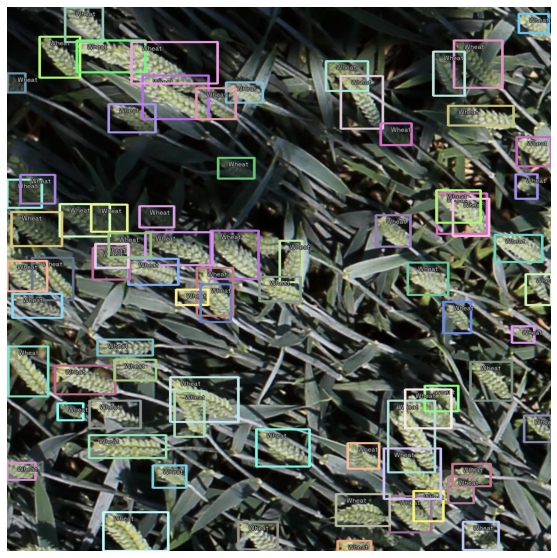

In [25]:
show_record(train_records[4], #class_map=class_map, 
            figsize = (10,10) )#,font_size=20, label_color = '#ffff00')

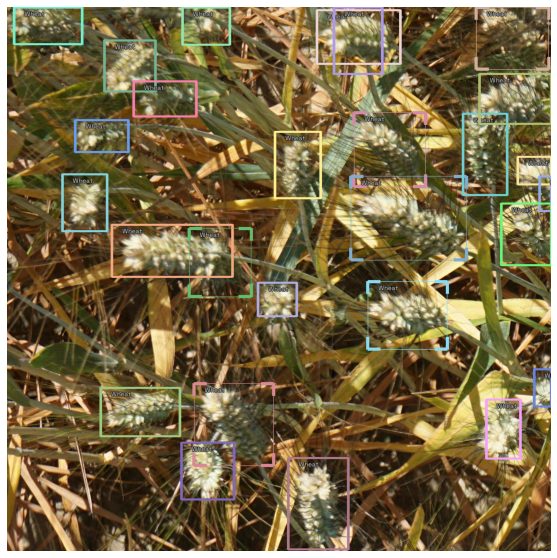

In [26]:
show_record(train_records[0], #class_map=class_map, 
            figsize = (10,10), diplay_label=False)#,font_size=20, label_color = '#ffff00')

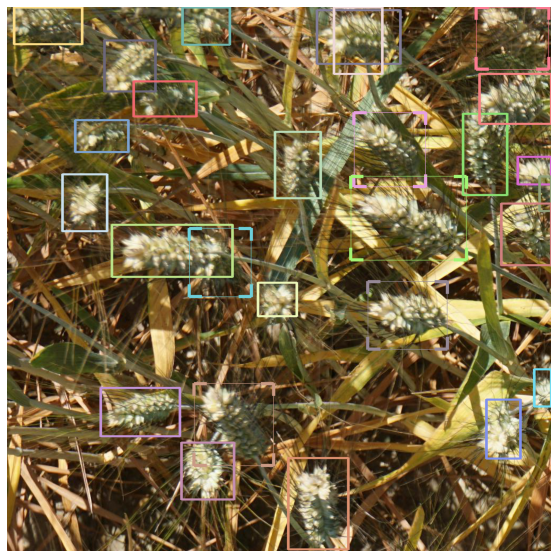

In [59]:
show_record(train_records[0], 
            figsize = (10,10), display_label=False)

In [27]:
train_records[0]

BaseRecord

common: 
	- Filepath: /content/global-wheat-detection/train/82775d15c.jpg
	- Img: None
	- Image size ImgSize(width=1024, height=1024)
	- Record ID: 1037
detection: 
	- Class Map: <ClassMap: {'background': 0, 'wheat': 1}>
	- Labels: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
	- BBoxes: [<BBox (xmin:183.0, ymin:62.0, xmax:279.0, ymax:159.0)>, <BBox (xmin:238.0, ymin:139.0, xmax:356.0, ymax:206.0)>, <BBox (xmin:128.0, ymin:212.0, xmax:228.0, ymax:273.0)>, <BBox (xmin:104.0, ymin:314.0, xmax:188.0, ymax:422.0)>, <BBox (xmin:197.0, ymin:409.0, xmax:424.0, ymax:508.0)>, <BBox (xmin:504.0, ymin:234.0, xmax:590.0, ymax:360.0)>, <BBox (xmin:653.0, ymin:198.0, xmax:787.0, ymax:338.0)>, <BBox (xmin:647.0, ymin:318.0, xmax:864.0, ymax:476.0)>, <BBox (xmin:858.0, ymin:200.0, xmax:941.0, ymax:354.0)>, <BBox (xmin:889.0, ymin:125.0, xmax:1024.0, ymax:220.0)>, <BBox (xmin:961.0, ymin:281.0, xmax:1024.0, ymax:334.0)>, <BBox (xmin:1002.0, ymin:318.0, xm

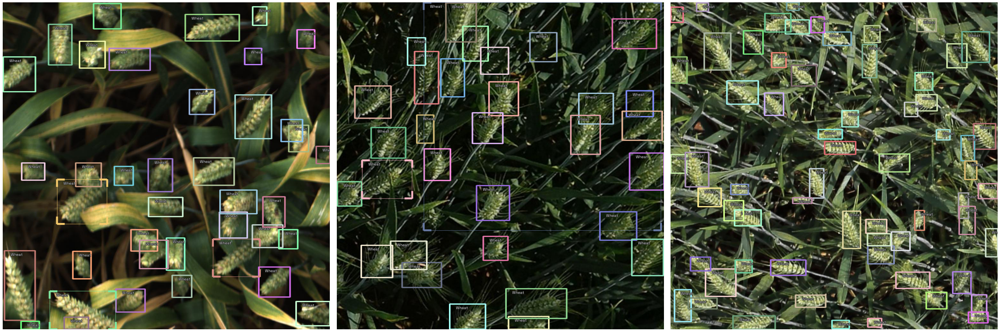

In [29]:
show_records(train_records[1:4], ncols=3)#,
            # font_size=60, label_color = '#ff5000')

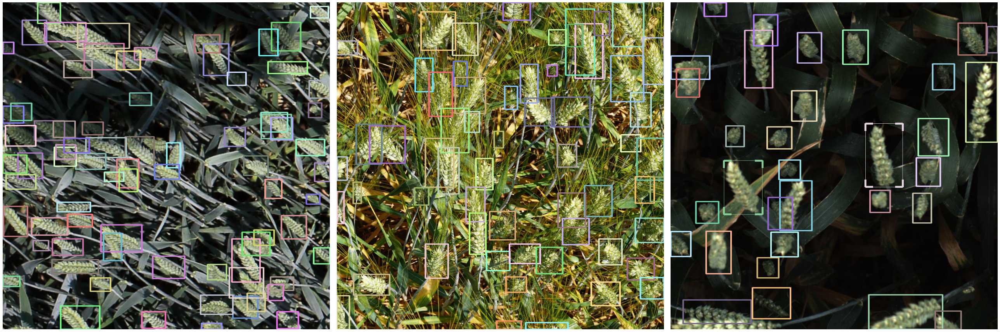

In [60]:
show_records(train_records[4:7], ncols=3, display_label=False)#,


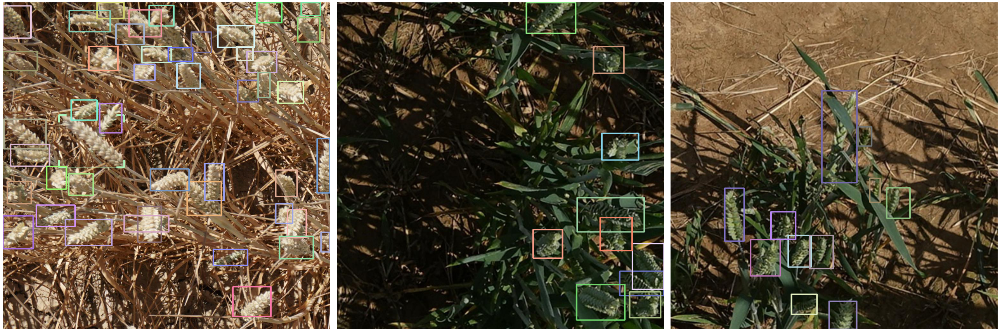

In [66]:
show_records(train_records[7:10], ncols=3, display_label=False)#,

In [30]:
presize = 512
image_size = 384

train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=image_size), tfms.A.Normalize()])

In [33]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

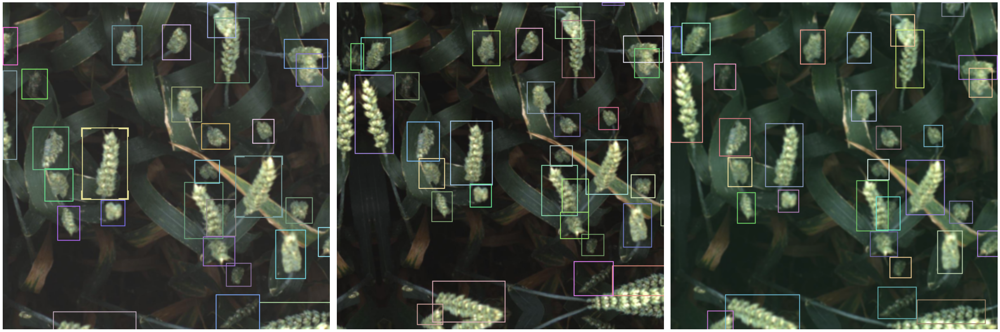

In [36]:
samples = [train_ds[6] for _ in range(3)]
show_samples(samples, ncols=3, display_label=False)#, font_size=30, label_color = '#ffff00')

In [37]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


SuggestedLRs(lr_min=0.0002511886414140463, lr_steep=1.2022644114040304e-05)

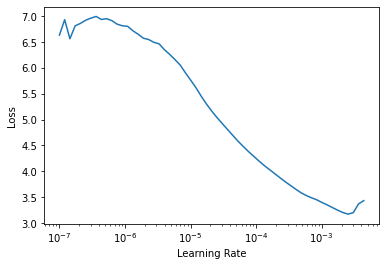

In [38]:
model_type_frcnn = models.torchvision.faster_rcnn ##
model_frcnn = model_type_frcnn.model( ##
                      num_classes=len(parser.class_map))

train_dl_frcnn = model_type_frcnn.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_frcnn = model_type_frcnn.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)

learn_frcnn = model_type_frcnn.fastai.learner(dls=[train_dl_frcnn, ###
                                                   valid_dl_frcnn], #
                                              model=model_frcnn, metrics=metrics)#
learn_frcnn.lr_find()#

In [39]:
learn_frcnn.fine_tune(10, 3e-4, freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,6.141935,5.814960,0.091278,04:20


epoch,train_loss,valid_loss,COCOMetric,time
0,1.411606,1.271583,0.244191,05:19
1,1.218778,1.113830,0.309804,05:03
2,1.138254,1.038620,0.328709,05:07
3,1.081363,0.980190,0.368698,05:02
4,1.049599,0.947201,0.391918,05:01
5,1.024864,0.921311,0.397284,04:59
6,0.989322,0.904754,0.402829,04:57
7,0.983794,0.898926,0.409172,04:59
8,0.978234,0.894627,0.407164,04:57
9,0.963071,0.892016,0.411084,04:58


In [40]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())#
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.25, 'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,1.2);

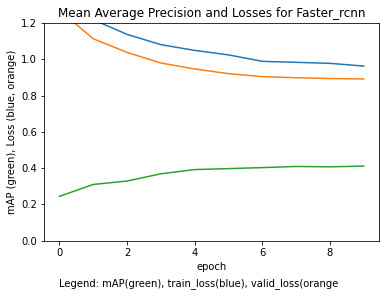

In [41]:
plot_metrics(learn_frcnn, 'Mean Average Precision and Losses for Faster_rcnn')

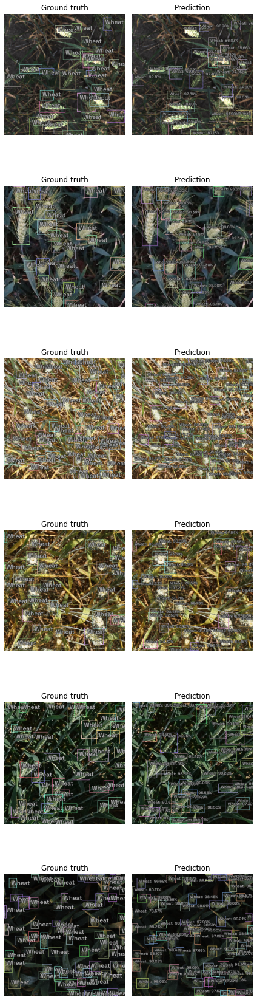

In [42]:
model_type_frcnn.show_results(model_frcnn, valid_ds) # class_map rem

  0%|          | 0.00/14.1M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


SuggestedLRs(lr_min=0.004786301031708717, lr_steep=1.0964781722577754e-06)

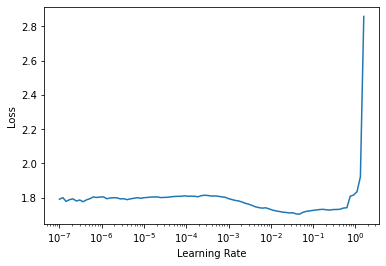

In [43]:
model_type_yolo = models.ultralytics.yolov5 ##
backbone_yolo = model_type_yolo.backbones.small #
model_yolo = model_type_yolo.model(backbone = backbone_yolo(pretrained=True), ###
                      num_classes=len(parser.class_map),
                      img_size = image_size)#
train_dl_yolo = model_type_yolo.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_yolo = model_type_yolo.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)
                                       
learn_yolo = model_type_yolo.fastai.learner(dls=[train_dl_yolo, ###
                                                   valid_dl_yolo], #
                                              model=model_yolo, metrics=metrics)#
learn_yolo.lr_find()#

In [44]:
learn_yolo.fine_tune(10, 5e-3 , freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,1.741179,1.728851,0.041909,02:30


epoch,train_loss,valid_loss,COCOMetric,time
0,1.353247,1.273962,0.223966,02:29
1,1.217436,1.151867,0.313806,02:28
2,1.164186,1.104840,0.368976,02:28
3,1.140681,1.056354,0.404475,02:27
4,1.109877,1.054231,0.376601,02:26
5,1.086156,1.027534,0.422752,02:26
6,1.072481,1.007084,0.442975,02:26
7,1.071060,1.003095,0.445413,02:26
8,1.059055,0.998473,0.449053,02:26
9,1.062057,0.997842,0.446238,02:27


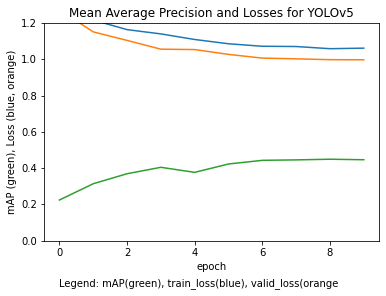

In [45]:
 plot_metrics(learn_yolo, 'Mean Average Precision and Losses for YOLOv5')

  0%|          | 0/152149505 [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/mmcv/cnn/utils/weight_init.py:119: UserWarning: init_cfg without layer key, if you do not define override key either, this init_cfg will do nothing
  'init_cfg without layer key, if you do not define override'


Use load_from_local loader
The model and loaded state dict do not match exactly

size mismatch for bbox_head.retina_cls.weight: copying a param with shape torch.Size([720, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([9, 256, 3, 3]).
size mismatch for bbox_head.retina_cls.bias: copying a param with shape torch.Size([720]) from checkpoint, the shape in current model is torch.Size([9]).


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


SuggestedLRs(lr_min=8.317637839354575e-05, lr_steep=0.00015848931798245758)

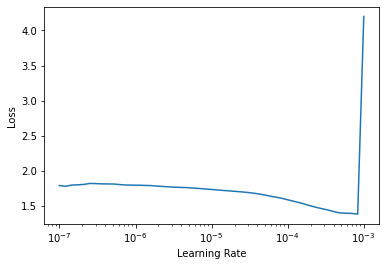

In [46]:
model_type_ret = models.mmdet.retinanet #
backbone_r50 = model_type_ret.backbones.resnet50_fpn_1x(pretrained=True)#
model_ret = model_type_ret.model(backbone=backbone_r50(pretrained=True), #
                      num_classes=len(parser.class_map))

train_dl_ret = model_type_ret.train_dl(train_ds, batch_size=16, num_workers=4, shuffle=True)#
valid_dl_ret = model_type_ret.valid_dl(valid_ds, batch_size=16, num_workers=4, shuffle=False)#

learn_ret = model_type_ret.fastai.learner(dls=[train_dl_ret, valid_dl_ret], model=model_ret, metrics=metrics)#
learn_ret.lr_find()#

In [47]:
learn_ret.fine_tune(10, 8e-5 , freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.807718,0.681343,0.174484,04:23


epoch,train_loss,valid_loss,COCOMetric,time
0,0.635127,0.611518,0.234959,04:33
1,0.588664,0.566087,0.275079,04:34
2,0.557695,0.522735,0.317790,04:34
3,0.536054,0.507980,0.333252,04:34
4,0.524845,0.497189,0.346815,04:36
5,0.509760,0.490355,0.346964,04:34
6,0.506323,0.482608,0.355678,04:34
7,0.496510,0.475545,0.362984,04:35
8,0.497510,0.474339,0.364119,04:36
9,0.499256,0.472685,0.364635,04:36


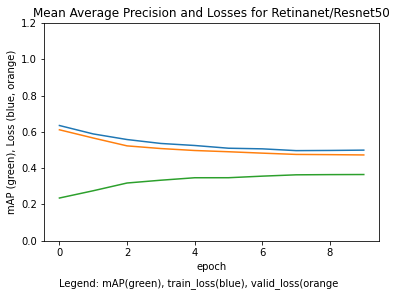

In [48]:
 plot_metrics(learn_ret, 'Mean Average Precision and Losses for Retinanet/Resnet50')

Downloading: "https://github.com/rwightman/efficientdet-pytorch/releases/download/v0.1/tf_efficientdet_lite0-f5f303a9.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientdet_lite0-f5f303a9.pth
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


SuggestedLRs(lr_min=0.017378008365631102, lr_steep=0.005248074419796467)

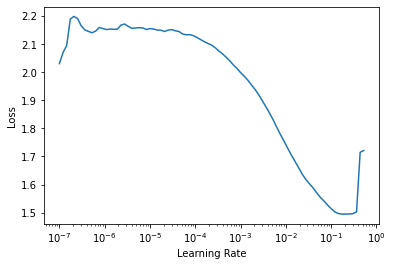

In [49]:
model_type_eff = models.ross.efficientdet ##
backbone_eff = model_type_eff.backbones.tf_lite0#
model_eff = model_type_eff.model(backbone = backbone_eff(pretrained=True), ##
                      num_classes=len(parser.class_map),
                      img_size = image_size)#
train_dl_eff = model_type_eff.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_eff = model_type_eff.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)
                                       
learn_eff = model_type_eff.fastai.learner(dls=[train_dl_eff, ###
                                                   valid_dl_eff], #
                                              model=model_eff, metrics=metrics)#
learn_eff.lr_find()#

In [50]:
learn_eff.fine_tune(10, 2e-2, freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.979097,1.102008,0.026049,03:50


epoch,train_loss,valid_loss,COCOMetric,time
0,0.654094,0.620719,0.237345,03:51
1,0.586925,0.590914,0.276831,03:48
2,0.566619,0.550960,0.305472,03:51
3,0.541830,0.515630,0.337078,03:50
4,0.526932,0.551397,0.302625,03:48
5,0.506956,0.470494,0.369758,03:48
6,0.491811,0.455041,0.387242,03:47
7,0.475971,0.461056,0.377135,03:47
8,0.467984,0.439939,0.399699,03:47
9,0.464944,0.438247,0.400849,03:48


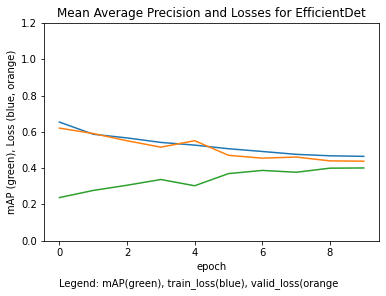

In [52]:
plot_metrics(learn_eff, 'Mean Average Precision and Losses for EfficientDet')

SuggestedLRs(lr_min=7.585775847473997e-08, lr_steep=4.786300905834651e-06)

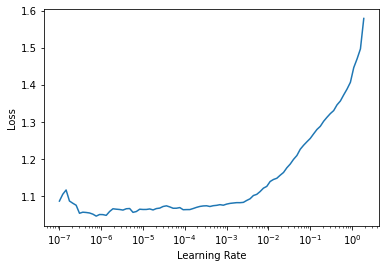

In [53]:
## final model use yolo

# extend using differing lr's
learn_yolo.lr_find()#

In [54]:
from fastai.callback.tracker import SaveModelCallback
fname='wheat-yolo-best'
learn_yolo.unfreeze()
# will not use suggested lr_min, use graph
learn_yolo.fit_one_cycle(10, 1e-5, cbs=SaveModelCallback(monitor='COCOMetric', fname=fname))
# valid losses still going down -> extend training

epoch,train_loss,valid_loss,COCOMetric,time
0,1.056890,0.997446,0.446268,02:30
1,1.053411,0.993682,0.452078,02:28
2,1.043656,0.992593,0.451469,02:27
3,1.053405,0.991682,0.450686,02:27
4,1.039012,0.986733,0.455183,02:27
5,1.038402,0.986403,0.456353,02:27
6,1.040439,0.984535,0.456983,02:27
7,1.043575,0.985315,0.455949,02:26
8,1.043538,0.985033,0.457373,02:26
9,1.046341,0.984976,0.457066,02:28


Better model found at epoch 0 with COCOMetric value: 0.44626765981668237.
Better model found at epoch 1 with COCOMetric value: 0.4520780591090046.
Better model found at epoch 4 with COCOMetric value: 0.455183104883342.
Better model found at epoch 5 with COCOMetric value: 0.4563529775633026.
Better model found at epoch 6 with COCOMetric value: 0.4569830317539344.
Better model found at epoch 8 with COCOMetric value: 0.4573726388055886.


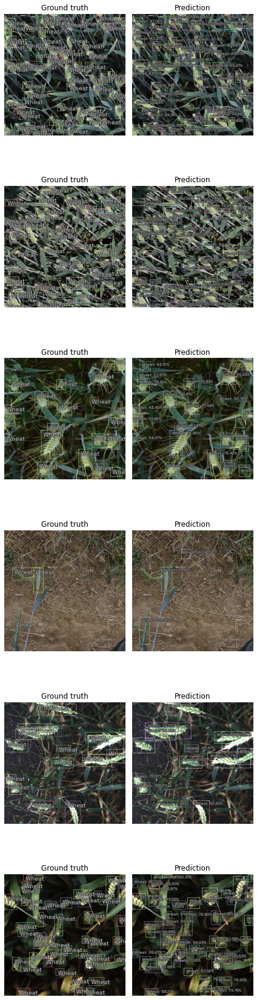

In [55]:
model_type_yolo.show_results(model_yolo, valid_ds) 

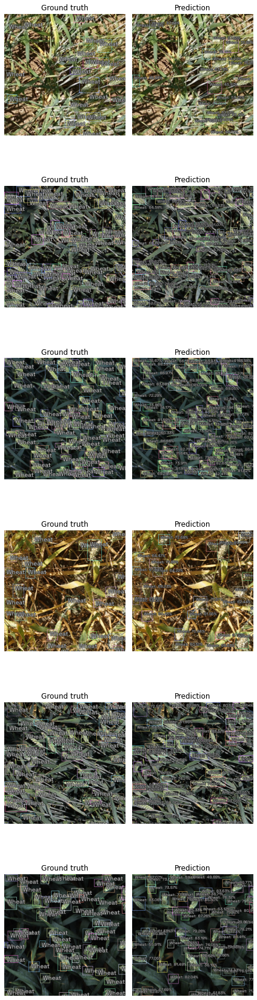

In [56]:
model_type_yolo.show_results(model_yolo, valid_ds) # class_map rem

SuggestedLRs(lr_min=7.585775892948732e-06, lr_steep=9.12010818865383e-07)

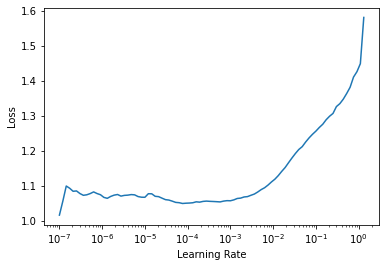

In [57]:
learn_yolo.lr_find()#

In [58]:
# 3rd cycle
fname='wheat-yolo-best-3rd'
learn_yolo.unfreeze()
learn_yolo.fit_one_cycle(10, 1e-05, cbs=SaveModelCallback(monitor='COCOMetric', fname=fname))

epoch,train_loss,valid_loss,COCOMetric,time
0,1.035870,0.985303,0.456187,02:30
1,1.050977,0.985572,0.457877,02:32
2,1.040001,0.984048,0.456722,02:34
3,1.036485,0.983151,0.456501,02:29
4,1.028771,0.982033,0.458272,02:30
5,1.040024,0.981497,0.458493,02:28
6,1.027051,0.979949,0.458754,02:28
7,1.022418,0.979826,0.459226,02:28
8,1.034282,0.978607,0.459896,02:28
9,1.024768,0.978843,0.459922,02:27


Better model found at epoch 0 with COCOMetric value: 0.45618698788869233.
Better model found at epoch 1 with COCOMetric value: 0.4578770301165143.
Better model found at epoch 4 with COCOMetric value: 0.4582723466611605.
Better model found at epoch 5 with COCOMetric value: 0.4584925041240266.
Better model found at epoch 6 with COCOMetric value: 0.45875421172281516.
Better model found at epoch 7 with COCOMetric value: 0.4592259513108239.
Better model found at epoch 8 with COCOMetric value: 0.45989615918475485.
Better model found at epoch 9 with COCOMetric value: 0.4599215547497131.


SuggestedLRs(lr_min=3.311311274956097e-07, lr_steep=9.12010818865383e-07)

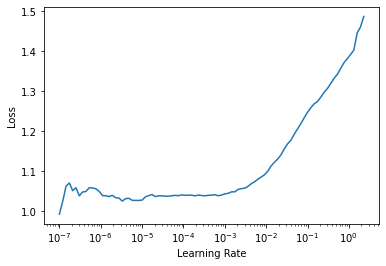

In [61]:
learn_yolo.lr_find()#

In [62]:
# 4th cycle
fname='wheat-yolo-best-4th'
learn_yolo.unfreeze()
learn_yolo.fit_one_cycle(10, 1e-5, cbs=SaveModelCallback(monitor='COCOMetric', fname=fname))

epoch,train_loss,valid_loss,COCOMetric,time
0,1.032312,0.979163,0.459756,02:33
1,1.034129,0.980867,0.456601,02:31
2,1.029305,0.978614,0.459294,02:29
3,1.034859,0.976939,0.460570,02:31
4,1.027758,0.974994,0.461736,02:29
5,1.023335,0.973940,0.463099,02:28
6,1.023810,0.975511,0.461480,02:27
7,1.023588,0.973665,0.463681,02:26
8,1.015206,0.973335,0.463308,02:26
9,1.016919,0.973314,0.463273,02:28


Better model found at epoch 0 with COCOMetric value: 0.4597555926261055.
Better model found at epoch 3 with COCOMetric value: 0.46056979680211246.
Better model found at epoch 4 with COCOMetric value: 0.461735630577179.
Better model found at epoch 5 with COCOMetric value: 0.46309912549760013.
Better model found at epoch 7 with COCOMetric value: 0.4636814301385167.


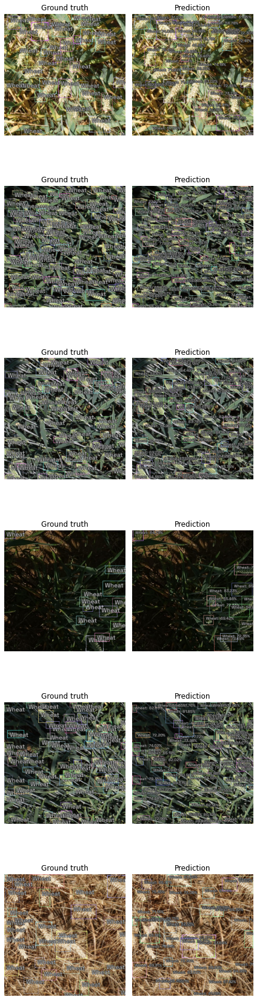

In [65]:
model_type_yolo.show_results(model_yolo, valid_ds) 

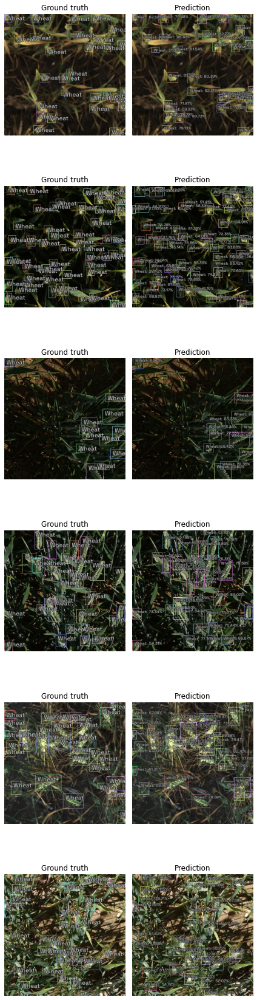

In [63]:
model_type_yolo.show_results(model_yolo, valid_ds) 

In [67]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
root_dir = Path('/content/gdrive/My Drive/')

Mounted at /content/gdrive


In [68]:
#best model
!ls models

wheat-yolo-best-3rd.pth  wheat-yolo-best-4th.pth  wheat-yolo-best.pth


In [71]:
!cp models/wheat-yolo-best-4th.pth /content/gdrive/"My Drive"/models/wheat-yolo-best-4th.pth
#!cp models/bccd-faster-rcnn-best.pth /content/gdrive/"My Drive"/models/bccd-faster-rcnn-best.pth